# Importing packages

In [1]:
!pip install torch-summary
!pip install torchmetrics

     |████████████████████████████████| 332 kB 4.2 MB/s 


In [2]:
from google.colab import drive
drive._mount("/content/gdrive", force_remount=True)

Mounted at /content/gdrive


Переходим в рабочую директорию проекта.

In [3]:
%cd "/content/gdrive/MyDrive/NSU-DNN_Course/In_the_blue_sea_white_foam"

/content/gdrive/MyDrive/NSU-DNN_Course/In_the_blue_sea_white_foam


Перенесла все описанные в https://colab.research.google.com/drive/1wzUOm2_cR1OiP7K1V1Syh--k00riW6U6#scrollTo=U0996ar3e4u4 (Went to the bottom.ipynb) функции в .py файлы

In [4]:
import sys
sys.path.append('./utils/')
from dataset import *
from training import *

In [5]:
import os
from os.path import join
from pathlib import Path
import glob

import random
import numpy as np 
import pandas as pd

from PIL import Image
import torch
%load_ext tensorboard
from torch.utils import tensorboard as tboard
from torch.utils.data import Dataset, DataLoader
from torchvision import transforms, utils, models

from collections import OrderedDict
from torch import nn
from torchsummary import summary
import torchmetrics as tm

import matplotlib.pyplot as plt

In [6]:
def set_random_seed(rs):
    torch.manual_seed(rs)
    random.seed(rs)
    np.random.seed(rs)

In [7]:
!ls

'At_the_bottom_MobileNetV3Large_(eval).ipynb'
'At the bottom - MobileNetV3Large (val - batch 85).ipynb'
'At the bottom - Multiclass_Classificator.ipynb'
 checkpoints
 Fish_Dataset
 kaggle.json
 labels_decoder.csv
 license.txt
 logs
 logs_eval
 NA_Fish_Dataset
 non-augmented_test_data.csv
 non-augmented_train_data.csv
 non-augmented_val_data.csv
 README.txt
 Segmentation_example_script.m
 utils
 Went_to_the_bottom.ipynb
'Кодирование классов.ipynb'


# Global variables

In [8]:
rs = 76

In [9]:
device = torch.device('cuda:0' if torch.cuda.is_available() else 'cpu')

In [10]:
nclasses = 9

In [11]:
reduced_metrics_list = [
    nn.CrossEntropyLoss(reduction = 'mean'),
    tm.Accuracy(num_classes=nclasses).to(device),
    tm.AUROC(num_classes=nclasses).to(device),
]

/usr/local/lib/python3.7/dist-packages/torchmetrics/utilities/prints.py:36: UserWarning: Metric `AUROC` will save all targets and predictions in buffer. For large datasets this may lead to large memory footprint.
  warnings.warn(*args, **kwargs)


In [12]:
full_metrics_list= [
    nn.CrossEntropyLoss(reduction = 'mean'),
    
    tm.Accuracy(num_classes=nclasses, average='micro').to(device),
    tm.Accuracy(num_classes=nclasses, average='macro').to(device),
    tm.Accuracy(num_classes=nclasses, average='weighted').to(device),
    tm.Accuracy(num_classes=nclasses, average=None).to(device),
    
    tm.F1(num_classes=nclasses, average='micro').to(device), 
    tm.F1(num_classes=nclasses, average='macro').to(device), 
    tm.F1(num_classes=nclasses, average='weighted').to(device), 
    tm.F1(num_classes=nclasses, average=None).to(device), 

    tm.Precision(num_classes=nclasses, average='micro').to(device), 
    tm.Precision(num_classes=nclasses, average='macro').to(device), 
    tm.Precision(num_classes=nclasses, average='weighted').to(device), 
    tm.Precision(num_classes=nclasses, average=None).to(device), 

    tm.Recall(num_classes=nclasses, average='micro').to(device), 
    tm.Recall(num_classes=nclasses, average='macro').to(device), 
    tm.Recall(num_classes=nclasses, average='weighted').to(device), 
    tm.Recall(num_classes=nclasses, average=None).to(device), 
]

## Dataloaders

In [13]:
side = 224

In [14]:
aug_transforms = transforms.Compose([
    transforms.Resize(size=side, interpolation=transforms.InterpolationMode.BICUBIC),
    transforms.Pad(padding=(side//2, side//2), padding_mode='symmetric'),
    RandomRotationBySpace(angles=np.arange(0., 360., 45.0), interpolation=transforms.InterpolationMode.BICUBIC, expand=False),
    transforms.CenterCrop(size=(side + 0.25*side, side + 0.25*side)), 
    transforms.Resize(size=side, interpolation=transforms.InterpolationMode.BICUBIC),
    transforms.RandomVerticalFlip(p=0.5),
    transforms.RandomAutocontrast(p=0.5), 
    transforms.ToTensor(), 
    transforms.Normalize(
        mean=[0.485, 0.456, 0.406],
        std=[0.229, 0.224, 0.225]
    )
])

In [15]:
no_aug_transforms = transforms.Compose([
    transforms.Resize(size=side, interpolation=transforms.InterpolationMode.BICUBIC),
    transforms.Pad(padding=side//2, padding_mode='symmetric'),
    transforms.CenterCrop(size=(side + 0.25*side, side + 0.25*side)), 
    transforms.Resize(size=side, interpolation=transforms.InterpolationMode.BICUBIC),
    transforms.ToTensor(), 
    transforms.Normalize(
        mean=[0.485, 0.456, 0.406],
        std=[0.229, 0.224, 0.225]
    )
])

Что важно помнить при итерировании по дэйтасету - изначально, это просто оригинальный набор изображений, к которым были применены преобразования. Это не аугментированный набор из N * 32 снимков. Чтобы получить аугментированную выборку, требуется несколько раз (максимум 32) проитерироваться (внешним циклом) по всему дэйтасету из N снимков.
Будем придерживаться правила, что одна эпоха обучения должна проводится по всему набору изображений. Т.е. по N * 32.  
UPD: Так как логирую по эпохам в tensorboard - за две эпохи выполняю полный проход по дейтасету.

In [16]:
train_imgs_dataset = Multiclass_Dataset(csv_file_patch=join('.', "non-augmented_train_data.csv"), imgs_transforms=aug_transforms)
val_imgs_dataset = Multiclass_Dataset(csv_file_patch=join('.', "non-augmented_val_data.csv"), imgs_transforms=aug_transforms)
test_imgs_dataset = Multiclass_Dataset(csv_file_patch=join('.', "non-augmented_test_data.csv"), imgs_transforms=aug_transforms)
len(train_imgs_dataset), len(val_imgs_dataset), len(test_imgs_dataset)

(215, 85, 129)

In [17]:
no_aug_test_imgs_dataset = Multiclass_Dataset(csv_file_patch=join('.', "non-augmented_test_data.csv"), imgs_transforms=no_aug_transforms)

In [18]:
(215 / 5, 85 / 5, 129 / 3)

(43.0, 17.0, 43.0)

In [19]:
train_batch_size = 215
val_batch_size = 85
test_batch_size = 129

In [20]:
set_random_seed(rs)
train_dataloader = DataLoader(train_imgs_dataset, batch_size=train_batch_size, shuffle=True)
val_dataloader = DataLoader(val_imgs_dataset, batch_size=val_batch_size, shuffle=True)
test_dataloader = DataLoader(test_imgs_dataset, batch_size=test_batch_size, shuffle=False)
len(train_dataloader), len(val_dataloader), len(test_dataloader)

(1, 1, 1)

In [21]:
set_random_seed(rs)
no_aug_test_dataloader_bs43 = DataLoader(no_aug_test_imgs_dataset, batch_size=43, shuffle=False)

In [22]:
del train_imgs_dataset, val_imgs_dataset, test_imgs_dataset, no_aug_test_imgs_dataset

In [23]:
labels_decoder_s = pd.read_csv(join('.', "labels_decoder.csv"), index_col=0, squeeze=True)
labels_decoder_s

0       Black Sea Sprat
1       Gilt Head Bream
2        Horse Mackerel
3            Red Mullet
4         Red Sea Bream
5              Sea Bass
6                Shrimp
7    Striped Red Mullet
8                 Trout
Name: class_name, dtype: object

# Plot 

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


0 torch.Size([43, 3, 224, 224]) torch.Size([43])
labels: ['Black Sea Sprat' 'Black Sea Sprat' 'Black Sea Sprat' 'Black Sea Sprat'
 'Black Sea Sprat' 'Black Sea Sprat' 'Black Sea Sprat' 'Black Sea Sprat'
 'Black Sea Sprat' 'Black Sea Sprat' 'Black Sea Sprat' 'Black Sea Sprat'
 'Black Sea Sprat' 'Black Sea Sprat' 'Black Sea Sprat' 'Gilt Head Bream'
 'Gilt Head Bream' 'Gilt Head Bream' 'Gilt Head Bream' 'Gilt Head Bream'
 'Gilt Head Bream' 'Gilt Head Bream' 'Gilt Head Bream' 'Gilt Head Bream'
 'Gilt Head Bream' 'Gilt Head Bream' 'Gilt Head Bream' 'Gilt Head Bream'
 'Gilt Head Bream' 'Gilt Head Bream' 'Horse Mackerel' 'Horse Mackerel'
 'Horse Mackerel' 'Horse Mackerel' 'Horse Mackerel' 'Horse Mackerel'
 'Horse Mackerel' 'Horse Mackerel' 'Horse Mackerel' 'Horse Mackerel'
 'Horse Mackerel' 'Horse Mackerel' 'Horse Mackerel']


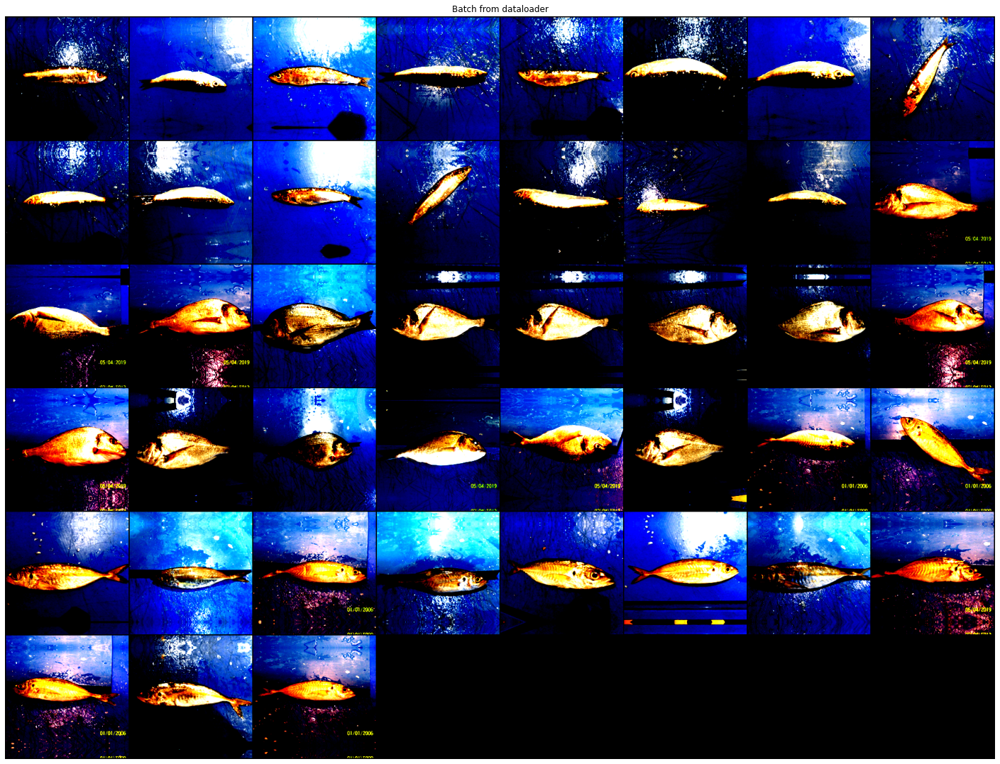

In [ ]:
show_some_data_samples(no_augmentedtest_dataloader_bs43, labels_decoder_s, 1)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


0 torch.Size([43, 3, 224, 224]) torch.Size([43])
labels: ['Black Sea Sprat' 'Black Sea Sprat' 'Black Sea Sprat' 'Black Sea Sprat'
 'Black Sea Sprat' 'Black Sea Sprat' 'Black Sea Sprat' 'Black Sea Sprat'
 'Black Sea Sprat' 'Black Sea Sprat' 'Black Sea Sprat' 'Black Sea Sprat'
 'Black Sea Sprat' 'Black Sea Sprat' 'Black Sea Sprat' 'Gilt Head Bream'
 'Gilt Head Bream' 'Gilt Head Bream' 'Gilt Head Bream' 'Gilt Head Bream'
 'Gilt Head Bream' 'Gilt Head Bream' 'Gilt Head Bream' 'Gilt Head Bream'
 'Gilt Head Bream' 'Gilt Head Bream' 'Gilt Head Bream' 'Gilt Head Bream'
 'Gilt Head Bream' 'Gilt Head Bream' 'Horse Mackerel' 'Horse Mackerel'
 'Horse Mackerel' 'Horse Mackerel' 'Horse Mackerel' 'Horse Mackerel'
 'Horse Mackerel' 'Horse Mackerel' 'Horse Mackerel' 'Horse Mackerel'
 'Horse Mackerel' 'Horse Mackerel' 'Horse Mackerel']


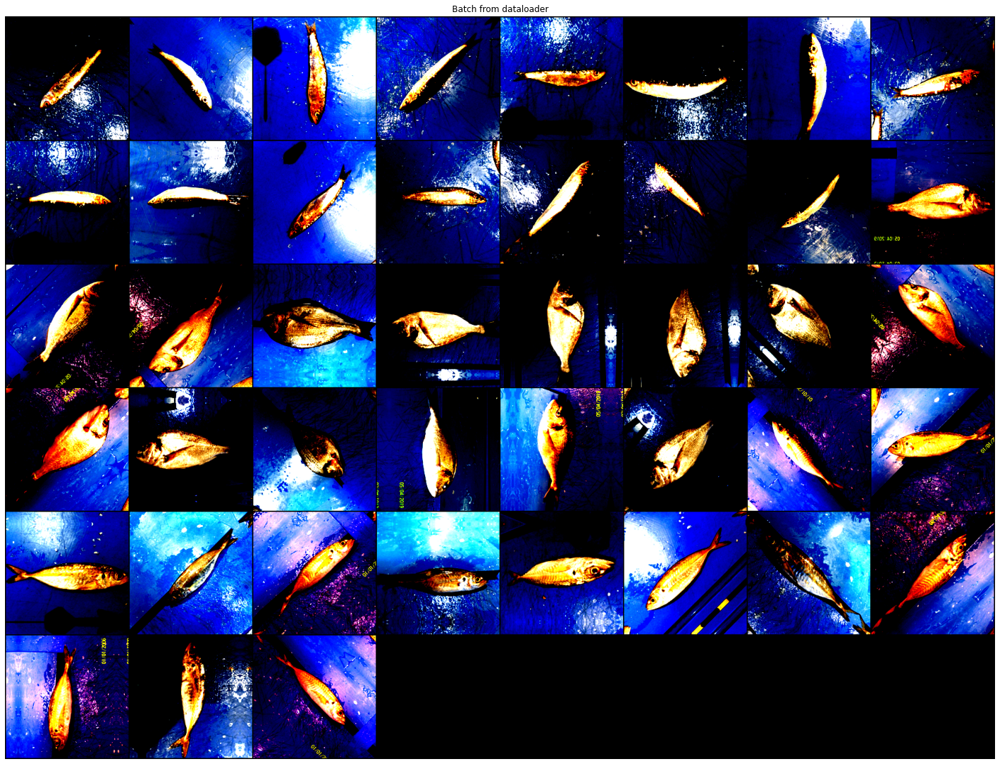

In [ ]:
show_some_data_samples(test_dataloader, labels_decoder_s, 1)

# Network

https://discuss.pytorch.org/t/how-to-modify-the-final-fc-layer-based-on-the-torch-model/766

In [24]:
class Multiclass_Classificator(nn.Module):
    def __init__(self, nchannels=3, nclasses=9, nfilters=32, nblocks=6, pretrained_weights=None):
        super(Multiclass_Classificator, self).__init__()        
        self.c = nfilters

        self.initial_layer = nn.Sequential(
            OrderedDict([
                (
                    f"conv7x7", 
                    nn.Conv2d(
                        in_channels=nchannels, out_channels=self.c,  
                        kernel_size=(7, 7),
                        stride=(2, 2), padding=(3, 3), padding_mode='zeros', 
                        bias=True
                    )
                ), (
                    f"prelu", 
                    nn.PReLU(num_parameters=self.c, init=0) # По сути, изначально это ReLu
                ), (
                    f"maxpool3x3",
                    torch.nn.MaxPool2d(kernel_size=(3, 3), stride=2)
                )
            ]) 
        )
        
        # Первая свертка - stride=1
        # Вторая свёртка - stride=2
        iconv = 0
        feature_extraction_layer_list =  []
        for i in range(nblocks):
            feature_extraction_layer_list.append((
                f"conv3x3_{iconv}_s1", 
                nn.Conv2d(
                    in_channels=self.c, out_channels=nfilters * 2 ** iconv,
                    kernel_size=(3, 3), 
                    stride=(1, 1), padding=(1, 1), padding_mode='zeros',
                    bias=True
                )
            ))
            feature_extraction_layer_list.append((
                f"bnorm{iconv}_1", 
                nn.BatchNorm2d(num_features=nfilters * 2 ** iconv)
            ))
            feature_extraction_layer_list.append((
                f"prelu{iconv}_1",
                nn.PReLU(num_parameters=nfilters * 2 ** iconv, init=0)
            ))

            feature_extraction_layer_list.append((
                f"conv3x3_{iconv}_s2", 
                nn.Conv2d(
                    in_channels=nfilters * 2 ** iconv, out_channels=nfilters * 2 ** iconv,
                    kernel_size=(3, 3), 
                    stride=(2, 2), padding=(1, 1), padding_mode='zeros',
                    bias=True
                )
            ))
            feature_extraction_layer_list.append((
                f"bnorm{iconv}_2", 
                nn.BatchNorm2d(num_features=nfilters * 2 ** iconv)
            ))
            feature_extraction_layer_list.append((
                f"prelu{iconv}_2",
                nn.PReLU(num_parameters=nfilters * 2 ** iconv, init=0)
            ))
            self.c = nfilters * 2 ** iconv
            iconv += 1
        self.feature_extraction_layer = nn.Sequential(OrderedDict(feature_extraction_layer_list))
        '''
        Мне категориески не нравится сильное падение лосса на обучении и застой на валидации.
        Пробовала также дообучить предобученные (без дропаута) веса с дропаутом - просто застревает.
        Попробую убрать lrelu перед dropout...
        '''
        self.final_layer = nn.Sequential(
            OrderedDict([
                (
                    f"avgpool", 
                    nn.AdaptiveAvgPool2d(output_size=(1, 1))
                ),(
                    "flatten",
                    nn.Flatten()
                ), (
                    "linear1", 
                    nn.Linear(
                        in_features=self.c,
                        out_features= nfilters * 2 ** nblocks,
                        bias=True
                    )
                ),(
                    f"dropout",               
                    nn.Dropout(p=0.2, inplace=True)
                ), (
                    "linear2", 
                    nn.Linear(
                        in_features=nfilters * 2 ** nblocks,
                        out_features=nclasses,
                        bias=True
                    )
                )
            ])
        )
    

    def forward(self, x):
        out = self.initial_layer(x)
        out = self.feature_extraction_layer(out)
        out = self.final_layer(out)

        return out

In [25]:
model = Multiclass_Classificator(nchannels=3, nclasses=9, nfilters=16, nblocks=4).to(device)

In [26]:
model

Multiclass_Classificator(
  (initial_layer): Sequential(
    (conv7x7): Conv2d(3, 16, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3))
    (prelu): PReLU(num_parameters=16)
    (maxpool3x3): MaxPool2d(kernel_size=(3, 3), stride=2, padding=0, dilation=1, ceil_mode=False)
  )
  (feature_extraction_layer): Sequential(
    (conv3x3_0_s1): Conv2d(16, 16, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (bnorm0_1): BatchNorm2d(16, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (prelu0_1): PReLU(num_parameters=16)
    (conv3x3_0_s2): Conv2d(16, 16, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1))
    (bnorm0_2): BatchNorm2d(16, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (prelu0_2): PReLU(num_parameters=16)
    (conv3x3_1_s1): Conv2d(16, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (bnorm1_1): BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (prelu1_1): PReLU(num_parameters=32)
    (conv3x3

In [27]:
summary(model, (3, 224, 224))

Layer (type:depth-idx)                   Output Shape              Param #
├─Sequential: 1-1                        [-1, 16, 55, 55]          --
|    └─Conv2d: 2-1                       [-1, 16, 112, 112]        2,368
|    └─PReLU: 2-2                        [-1, 16, 112, 112]        16
|    └─MaxPool2d: 2-3                    [-1, 16, 55, 55]          --
├─Sequential: 1-2                        [-1, 128, 4, 4]           --
|    └─Conv2d: 2-4                       [-1, 16, 55, 55]          2,320
|    └─BatchNorm2d: 2-5                  [-1, 16, 55, 55]          32
|    └─PReLU: 2-6                        [-1, 16, 55, 55]          16
|    └─Conv2d: 2-7                       [-1, 16, 28, 28]          2,320
|    └─BatchNorm2d: 2-8                  [-1, 16, 28, 28]          32
|    └─PReLU: 2-9                        [-1, 16, 28, 28]          16
|    └─Conv2d: 2-10                      [-1, 32, 28, 28]          4,640
|    └─BatchNorm2d: 2-11                 [-1, 32, 28, 28]          64
|  

Layer (type:depth-idx)                   Output Shape              Param #
├─Sequential: 1-1                        [-1, 16, 55, 55]          --
|    └─Conv2d: 2-1                       [-1, 16, 112, 112]        2,368
|    └─PReLU: 2-2                        [-1, 16, 112, 112]        16
|    └─MaxPool2d: 2-3                    [-1, 16, 55, 55]          --
├─Sequential: 1-2                        [-1, 128, 4, 4]           --
|    └─Conv2d: 2-4                       [-1, 16, 55, 55]          2,320
|    └─BatchNorm2d: 2-5                  [-1, 16, 55, 55]          32
|    └─PReLU: 2-6                        [-1, 16, 55, 55]          16
|    └─Conv2d: 2-7                       [-1, 16, 28, 28]          2,320
|    └─BatchNorm2d: 2-8                  [-1, 16, 28, 28]          32
|    └─PReLU: 2-9                        [-1, 16, 28, 28]          16
|    └─Conv2d: 2-10                      [-1, 32, 28, 28]          4,640
|    └─BatchNorm2d: 2-11                 [-1, 32, 28, 28]          64
|  

In [28]:
np.array([param.requires_grad for param in model.parameters()])

array([ True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True])

# Model training (0-5)

## Preparation for the training

In [29]:
loss = nn.CrossEntropyLoss(reduction = 'mean')
optimizer = torch.optim.Adam(model.parameters(), lr=1e-4)

In [30]:
exp_name = "Multiclass_Classificator"
logdir = Path(join('.', "logs_eval", exp_name))
logdir.mkdir(exist_ok=True, parents=True)
writer = tboard.SummaryWriter(logdir)

In [31]:
best_val_loss_value = np.inf
iepoch_best_model = 0
nepochs = 5 * 8
nextend = 4
# nextend = 32, но тогда для одной эпохи залогируемся всего раз
# Вместо этого уменьшим nextend и увеличим количество эпох

## Training

Сохраняю наилучшую модель, с точки зрения минимизации потерь на валидации.
Обучим полносвязный слой в течении 3 эпох на расширенном наборе.

In [35]:
for iepoch in range(0, nepochs):
    total_loss_value = train_one_epoch(model, train_dataloader, device, optimizer, loss, None, iepoch, nepochs, nextend=nextend, log_each=32)
    writer.add_scalar(f'train/loss', total_loss_value, global_step=iepoch)
    total_val_loss_value = validate(model, val_dataloader, device, loss, None, nextend=nextend)
    writer.add_scalar(f'val/loss', total_val_loss_value, global_step=iepoch)

    is_best = total_val_loss_value < best_val_loss_value
    if is_best:
        print(f"val_loss_value improved from {best_val_loss_value:.6f} to {total_val_loss_value:.6f}, saving model...")
        best_val_loss_value = total_val_loss_value
        iepoch_best_model = iepoch
        torch.save(model.state_dict(), join('.', 'checkpoints', f'{exp_name}.pth'))
    else:
      print(f"val_loss_value did not improve from {best_val_loss_value:.6f} on epoch {iepoch_best_model}")
torch.save(model.state_dict(), join('.', 'checkpoints', f'{exp_name}_{nepochs}iepoch.pth'))

Resulrts model training for epoch 1/40:
	Loss	: 2.190954	
	Loss val: 2.194771	
val_loss_value improved from inf to 2.194771, saving model...
Resulrts model training for epoch 2/40:
	Loss	: 2.161588	
	Loss val: 2.193366	
val_loss_value improved from 2.194771 to 2.193366, saving model...
Resulrts model training for epoch 3/40:
	Loss	: 2.127495	
	Loss val: 2.191572	
val_loss_value improved from 2.193366 to 2.191572, saving model...
Resulrts model training for epoch 4/40:
	Loss	: 2.084934	
	Loss val: 2.188709	
val_loss_value improved from 2.191572 to 2.188709, saving model...
Resulrts model training for epoch 5/40:
	Loss	: 2.027315	
	Loss val: 2.181208	
val_loss_value improved from 2.188709 to 2.181208, saving model...
Resulrts model training for epoch 6/40:
	Loss	: 1.971012	
	Loss val: 2.157127	
val_loss_value improved from 2.181208 to 2.157127, saving model...
Resulrts model training for epoch 7/40:
	Loss	: 1.910645	
	Loss val: 2.112977	
val_loss_value improved from 2.157127 to 2.112977,

# Model testing

In [32]:
del model

In [37]:
%tensorboard --logdir="./logs_eval/Multiclass_Classificator/"

<IPython.core.display.Javascript object>

In [33]:
model = Multiclass_Classificator(nclasses=9, nfilters=16, nblocks=4).to(device)
if device.type == "cpu":
    model.load_state_dict(torch.load(join('.', 'checkpoints', 'eval', f'{exp_name}_{nepochs}iepoch.pth'), map_location=torch.device('cpu')))
else: 
    model.load_state_dict(torch.load(join('.', 'checkpoints', 'eval', f'{exp_name}_{nepochs}iepoch.pth')))

In [34]:
model_metrics_val = evaluate(model, val_dataloader, reduced_metrics_list, device, nclasses=9, nextend=8)
model_metrics_val

./utils/training.py:141: UserWarning: Implicit dimension choice for softmax has been deprecated. Change the call to include dim=X as an argument.
  enc_labels_pred_softmax = nn.Softmax()(enc_labels_pred)


CrossEntropyLoss    0.771267
Accuracy (micro)    0.741176
AUROC (macro)       0.962858
Name: 0, dtype: float32

In [36]:
avarage_evaluate(model, no_aug_test_dataloader_bs43, device, loss)

loss 0.7123477856318156
accuracy 0.7829457322756449


# Model training (5 - 10)

In [37]:
optimizer = torch.optim.Adam(model.parameters(), lr=1e-5)

In [38]:
best_val_metric_value = model_metrics_val["Accuracy (micro)"]
iepoch_best_model = 38 
nepochs = (5 + 5) * 8  # Всего эпох (5 эпох обучено, ещё 5 обучим)
nextend = 4
metric = tm.Accuracy(num_classes=nclasses, average='micro').to(device)

In [39]:
nepochs

80

In [63]:
for iepoch in range(iepoch_best_model, nepochs): # 40 уже обучили
    total_loss_value = train_one_epoch(model, train_dataloader, device, optimizer, loss, None, iepoch, nepochs, nextend=nextend, log_each=32)
    writer.add_scalar(f'train/loss', total_loss_value, global_step=iepoch)
    total_val_loss_value, total_val_metric_value = validate(model, val_dataloader, device, loss, metric, nextend=nextend)
    writer.add_scalar(f'val/loss', total_val_loss_value, global_step=iepoch)
    writer.add_scalar(f'val/metric', total_val_metric_value, global_step=iepoch)

    is_best = total_val_metric_value > best_val_metric_value
    if is_best:
        print(f"val_metric_value improved from {best_val_metric_value:.6f} to {total_val_metric_value:.6f}, saving model...")
        best_val_metric_value = total_val_metric_value
        iepoch_best_model = iepoch
        torch.save(model.state_dict(), join('.', 'checkpoints', f'{exp_name}_.pth'))
    else:
      print(f"val_metric_value did not improve from {best_val_metric_value:.6f} on epoch {iepoch_best_model}")

Resulrts model training for epoch 39/80:
	Loss	: 0.382457	


./utils/training.py:88: UserWarning: Implicit dimension choice for softmax has been deprecated. Change the call to include dim=X as an argument.
  enc_labels_pred = nn.Softmax()(enc_labels_pred)


	Loss val: 0.746902	Metric val: 0.747059
val_metric_value improved from 0.730882 to 0.747059, saving model...
Resulrts model training for epoch 40/80:
	Loss	: 0.380449	
	Loss val: 0.748828	Metric val: 0.723529
val_metric_value did not improve from 0.747059 on epoch 38
Resulrts model training for epoch 41/80:
	Loss	: 0.377778	
	Loss val: 0.742210	Metric val: 0.741176
val_metric_value did not improve from 0.747059 on epoch 38
Resulrts model training for epoch 42/80:
	Loss	: 0.371757	
	Loss val: 0.724806	Metric val: 0.732353
val_metric_value did not improve from 0.747059 on epoch 38
Resulrts model training for epoch 43/80:
	Loss	: 0.366119	
	Loss val: 0.716010	Metric val: 0.744118
val_metric_value did not improve from 0.747059 on epoch 38
Resulrts model training for epoch 44/80:
	Loss	: 0.368863	
	Loss val: 0.728592	Metric val: 0.747059
val_metric_value did not improve from 0.747059 on epoch 38
Resulrts model training for epoch 45/80:
	Loss	: 0.364305	
	Loss val: 0.687793	Metric val: 0.78

# Model testing

In [40]:
del model

In [42]:
%tensorboard --logdir="./logs_eval/Multiclass_Classificator/"

<IPython.core.display.Javascript object>

In [45]:
best_model = Multiclass_Classificator(nchannels=3, nclasses=9, nfilters=16, nblocks=4).to(device)
if device.type == "cpu":
    best_model.load_state_dict(torch.load(join('.', 'checkpoints', 'eval', f'{exp_name}_.pth'), map_location=torch.device('cpu')))
else: 
    best_model.load_state_dict(torch.load(join('.', 'checkpoints', 'eval', f'{exp_name}_.pth')))

In [46]:
model_metrics_val = evaluate(best_model, test_dataloader, reduced_metrics_list, device, nclasses=9, nextend=8)
model_metrics_val

./utils/training.py:141: UserWarning: Implicit dimension choice for softmax has been deprecated. Change the call to include dim=X as an argument.
  enc_labels_pred_softmax = nn.Softmax()(enc_labels_pred)


CrossEntropyLoss    0.546123
Accuracy (micro)    0.837209
AUROC (macro)       0.981060
Name: 0, dtype: float32

In [ ]:
test_metrics_class1_value_s, test_metrics_class2_value_df = evaluate(
    best_model, 
    no_aug_test_dataloader_bs43, 
    full_metrics_list, 
    device, 
    nclasses=9, nextend=1
);

In [48]:
test_metrics_class1_value_s

CrossEntropyLoss        0.555064
Accuracy (micro)        0.844961
Accuracy (macro)        0.571983
Accuracy (weighted)     0.844961
F1 (micro)              0.844961
F1 (macro)              0.572284
F1 (weighted)           0.883030
Precision (micro)       0.844961
Precision (macro)       0.602588
Precision (weighted)    0.961607
Recall (micro)          0.844961
Recall (macro)          0.571983
Recall (weighted)       0.844961
Name: 0, dtype: float32

In [49]:
test_metrics_class2_value_df

,Accuracy,F1,Precision,Recall
0,1.000000,1.000000,1.000000,1.000000
1,0.400000,0.571429,1.000000,0.400000
2,0.800000,0.811111,0.854545,0.800000
3,1.000000,1.000000,1.000000,1.000000
4,0.733333,0.846154,1.000000,0.733333
5,0.933333,0.904348,0.877778,0.933333
6,1.000000,0.967742,0.937500,1.000000
7,0.866667,0.928571,1.000000,0.866667
8,0.888889,0.941177,1.000000,0.888889


In [50]:
avarage_evaluate(best_model, no_aug_test_dataloader_bs43, device, loss)

loss 0.5550642510255178
accuracy 0.8449612458546957


In [51]:
del best_model

# Fixing overfitting

In [ ]:
def get_fixing_Multiclass_Classificator(nchannels=3, nclasses=9, nfilters=32, nblocks=5):
    model = Multiclass_Classificator(nchannels=nchannels, nclasses=nclasses, nfilters=nfilters, nblocks=nblocks)
    
    for param in model.parameters():
        param.requires_grad = False

    model.final_layer = nn.Sequential(
        OrderedDict([
            (
                f"avgpool", 
                nn.AdaptiveAvgPool2d(output_size=(1, 1))
            ),(
                "flatten",
                nn.Flatten()
            ), (
                "linear1", 
                nn.Linear(
                    in_features=model.c,
                    out_features= nfilters * 2 ** nblocks,
                    bias=True
                )
            ),(
                f"lrelu", 
                nn.LeakyReLU() 
            ), (
                f"dropout",               # Единственное, что добавилось
                nn.Dropout(
                  p=0.2, inplace=True 
                )
            ), (
                "linear2", 
                nn.Linear(
                    in_features=nfilters * 2 ** nblocks,
                    out_features=nclasses,
                    bias=True
                )
            )
        ])
    )

    for param in model.parameters():
        param.requires_grad = True
    
    return model 

Так как дропаут не добавляет обучающих параметров, можем загрузить предобученные веса модели, которая еще не успела переобучиться. Но я предпочту начать обучение заново